# This cat does not exist
__Суммарное количество баллов: 10__

__Решение отправлять на `ml.course.practice@gmail.com`__

__Тема письма: `[ML][MS][HW06] <ФИО>`, где вместо `<ФИО>` указаны фамилия и имя__

Цель этого задания - создать котов, которых не существует. В ходе данного задания вы обучите DCGAN и VAE, которые являются одними из первых генеративных моделей. Для этого задания вам наверняка потребуется GPU с CUDA, поэтому рекомендуется использовать Google Colab.

In [ ]:
import torch
from torch import nn
from torch.optim import Adam
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import os 
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import random
import numpy as np

%matplotlib inline

In [ ]:
!nvidia-smi

Fri Jan 29 12:19:11 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   49C    P8     9W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
def random_noise(batch_size, channels, side_size):
    return torch.randn(batch_size, channels, side_size, side_size).cuda()

In [ ]:
def visualise(imgs, rows=2):
    imgs = (imgs.transpose(1, 3) + 1) / 2
    imgs = torch.cat([imgs[i::rows] for i in range(rows)], dim=1)
    cols = len(imgs)
    imgs = (torch.cat(list(imgs), dim=1)).cpu().numpy()[:, :, ::-1]
    plt.figure(figsize=(cols*1.5, rows*1.5))
    plt.imshow(imgs)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [ ]:
class CatDataset(Dataset):
    def __init__(self, path_to_dataset="cat_136", size=64):
        self.photo_names = os.listdir(path_to_dataset)
        self.path_base = path_to_dataset
        self.size = size
    
    def __getitem__(self, index):
        path = self.path_base + "/" + self.photo_names[index]
        img = cv2.imread(path) # 136 x 136
        crop_rate = 8
        x_crop = random.randint(0, crop_rate)
        y_crop = random.randint(0, crop_rate)
        img = img[x_crop:512 - crop_rate + x_crop, y_crop:512 - crop_rate + y_crop]
        img = cv2.resize(img, (self.size, self.size), interpolation=cv2.INTER_CUBIC)
        return 2 * torch.tensor(img).float().transpose(0, 2) / 255. - 1
    
    def __len__(self):
        return len(self.photo_names)

In [ ]:
!unzip cat_136.zip

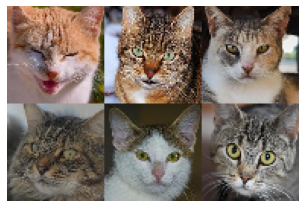

In [ ]:
dataset = CatDataset()
visualise(torch.cat([dataset[i].unsqueeze(0) for i in [3, 15, 182, 592, 394, 2941]], dim=0))

### Задание 1 (2 балла)
Для начала реализуем генератор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](imgs/DCGAN.png)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ConvTranspose2D`, `nn.ReLU`, а также функция `F.interpolate`.

#### Методы
* `__init__` - принимает на вход `start_size`, `latent_channels`, `start_channels` и `upsamplings`. Первые два аргумента отвечают за размер случайного шума, из которого в последствии будет сгенерирована картинка. `start_channels` отвечает за то, сколько каналов должно быть в картинке перед тем, как к ней будут применены upsampling блоки. `upsamplings` - это количество upsampling блоков, которые должны быть применены к картинке. В каждом таком локе количество каналов уменьшается в два раза.


* `forward` - принимает на вход `batch_size`, генерирует `batch_size` картинок из случайного шума.

In [ ]:
class Generator(nn.Module):
    def __init__(self, start_size=2, latent_channels=32, start_channels=1024, upsamplings=6):
        super().__init__()
        self.start_size, self.latent_channels = start_size, latent_channels
        self.conv1 = nn.Conv2d(latent_channels, start_channels, 1, 1, 0, bias=False)
        upsampling_blocks, in_channels = [], start_channels

        for _ in range(upsamplings):
            upsampling_blocks.append(
                nn.Sequential(
                    nn.ConvTranspose2d(in_channels, in_channels // 2, 4, 2, 1, bias=False), 
                    nn.BatchNorm2d(in_channels // 2), 
                    nn.ReLU()
                )
            )
            in_channels //= 2

        self.upsampling_blocks = nn.Sequential(*upsampling_blocks)
        self.conv2 = nn.Conv2d(in_channels, 3, 1, 1, 0, bias=False)
    
    def forward(self, batch_size: int):
        x = random_noise(batch_size, self.latent_channels, self.start_size)
        x = self.conv1(x)
        x = self.upsampling_blocks(x)
        x = torch.tanh(self.conv2(x))
        return x # torch.Tensor batch_size x 3 x (start_size * 2**upsamplings) x (start_size * 2**upsamplings)

### Задание 2 (2 балла)
Для начала реализуем дискриминатор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](imgs/Disc_DCGAN.png)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ReLU` и `nn.Sigmoid`.

#### Методы
* `__init__` - принимает на вход `start_channels` и `downsamplings`. `start_channels` определяет количество каналов, которые должны быть в изображении перед применением downsampling блоков.


* `forward` - принимает на вход `x` - тензор с картинками. Возвращает вектор с размерностью `batch_size`.

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, start_size=128, downsamplings=6, start_channels=8):
        super().__init__()
        self.conv1 = nn.Conv2d(3, start_channels, 1, 1, 0, bias=False)
        downsampling_blocks, in_channels = [], start_channels

        for _ in range(downsamplings):
            downsampling_blocks.append(
                nn.Sequential(
                    # kernel_size=4 выбрано специально. Как правило, лучше, чем kernel_size=3
                    # https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
                    nn.Conv2d(in_channels, in_channels * 2, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(in_channels * 2),
                    nn.ReLU()
                )
            )
            in_channels *= 2

        self.downsampling_blocks = nn.Sequential(*downsampling_blocks)
        h = w = start_size // 2 ** downsamplings
        self.fc1 = nn.Linear(in_channels * h * w, 1, bias=False)

    def forward(self, x):
        x = self.conv1(x)
        x = self.downsampling_blocks(x)
        x = x.flatten(start_dim=1)
        x = torch.sigmoid(self.fc1(x))
        return x # torch.Tensor batch_size x 1

In [ ]:
def train_gan():
    generator = Generator()
    discriminator = Discriminator()
    epochs = 120
    visualise_every = 10
    batch_size = 8
    generator.cuda()
    discriminator.cuda()

    gen_optim = Adam(generator.parameters(), lr=1e-4, betas=(0.5, 0.999))
    disc_optim = Adam(discriminator.parameters(), lr=1e-4, betas=(0.5, 0.999))

    dataset = CatDataset(size=128)

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        gen_loss_avg = 0
        disc_loss_avg = 0

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            # Positive update
            batch = batch.cuda()
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Negative update 
            batch = generator(batch_size).detach()
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.zeros_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Generator update
            batch = generator(batch_size)
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            gen_optim.zero_grad()
            loss.backward()
            gen_optim.step()
            gen_loss_avg += loss.item()
        
        if (ep + 1) % visualise_every == 0:
            with torch.no_grad():
                visualise(generator(6), rows=2)

        print(f"Epoch {ep+1} | Discriminator loss: {disc_loss_avg / total_batches} | Generator loss: {gen_loss_avg / total_batches}")


Epoch 1 | Discriminator loss: 0.20466967092820793 | Generator loss: 5.501132881141597



Epoch 2 | Discriminator loss: 0.216389640434513 | Generator loss: 5.434824841548197



Epoch 3 | Discriminator loss: 0.7020466215304758 | Generator loss: 3.1148913476315343



Epoch 4 | Discriminator loss: 0.8310124050950204 | Generator loss: 2.6703745638546734



Epoch 5 | Discriminator loss: 0.8507527044467391 | Generator loss: 2.4323756548558704



Epoch 6 | Discriminator loss: 0.8593712357821534 | Generator loss: 2.4764312442785466



Epoch 7 | Discriminator loss: 0.8049499821286614 | Generator loss: 2.601582792697486



Epoch 8 | Discriminator loss: 0.6869940815156511 | Generator loss: 2.79228209893896



Epoch 9 | Discriminator loss: 0.6305771105393466 | Generator loss: 3.151818385868339


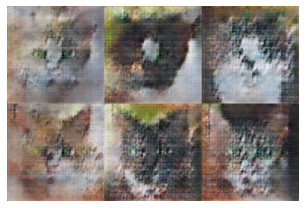

Epoch 10 | Discriminator loss: 0.5343841180884675 | Generator loss: 3.3771733671704434



Epoch 11 | Discriminator loss: 0.4622597905371724 | Generator loss: 3.7008598863106705



Epoch 12 | Discriminator loss: 0.45870189539163 | Generator loss: 3.791313797328043



Epoch 13 | Discriminator loss: 0.43813224811476165 | Generator loss: 4.076297108159164



Epoch 14 | Discriminator loss: 0.40980673853489363 | Generator loss: 3.876165967851137



Epoch 15 | Discriminator loss: 0.3688989516794949 | Generator loss: 4.359338201073386



Epoch 16 | Discriminator loss: 0.35209549595972883 | Generator loss: 4.661105566698572



Epoch 17 | Discriminator loss: 0.3392649791844718 | Generator loss: 4.504121628815528



Epoch 18 | Discriminator loss: 0.33916435996070576 | Generator loss: 4.711268478483888



Epoch 19 | Discriminator loss: 0.310044839944934 | Generator loss: 4.700529486542533


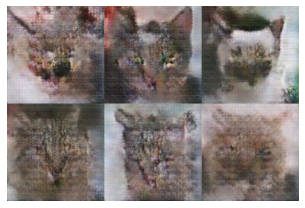

Epoch 20 | Discriminator loss: 0.2819148719544563 | Generator loss: 4.953984824998408



Epoch 21 | Discriminator loss: 0.3124484829824458 | Generator loss: 4.739846430487514



Epoch 22 | Discriminator loss: 0.3096488782657644 | Generator loss: 4.837005991511834



Epoch 23 | Discriminator loss: 0.28063457511116946 | Generator loss: 4.769183257490582



Epoch 24 | Discriminator loss: 0.2453100559451015 | Generator loss: 5.275232347711828



Epoch 25 | Discriminator loss: 0.2579477899116541 | Generator loss: 4.902065762359163



Epoch 26 | Discriminator loss: 0.2488676798118892 | Generator loss: 5.309138127643129



Epoch 27 | Discriminator loss: 0.27052338772913326 | Generator loss: 5.133008679803114



Epoch 28 | Discriminator loss: 0.27087974602436526 | Generator loss: 5.123216617829311



Epoch 29 | Discriminator loss: 0.25449215640948536 | Generator loss: 5.150546571280321


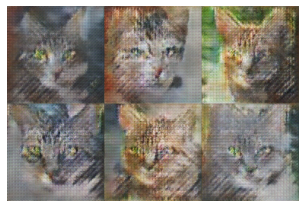

Epoch 30 | Discriminator loss: 0.2763056008846558 | Generator loss: 4.9304857589535835



Epoch 31 | Discriminator loss: 0.25074205966275287 | Generator loss: 5.381784118804502



Epoch 32 | Discriminator loss: 0.24046623666933284 | Generator loss: 5.401609922140281



Epoch 33 | Discriminator loss: 0.24913282720340651 | Generator loss: 5.11172088305032



Epoch 34 | Discriminator loss: 0.2555006666080586 | Generator loss: 5.251570074084382



Epoch 35 | Discriminator loss: 0.21504894941506547 | Generator loss: 5.529013752266302



Epoch 36 | Discriminator loss: 0.2522442781960209 | Generator loss: 5.259630748666591



Epoch 37 | Discriminator loss: 0.22568135001000178 | Generator loss: 5.332203485997197



Epoch 38 | Discriminator loss: 0.22550649837805953 | Generator loss: 5.569870345942352



Epoch 39 | Discriminator loss: 0.24402702719507047 | Generator loss: 5.614583615190494


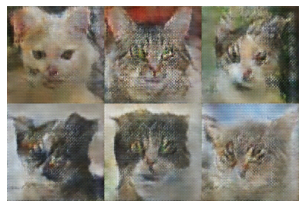

Epoch 40 | Discriminator loss: 0.2139723647229104 | Generator loss: 5.497331862285826



Epoch 41 | Discriminator loss: 0.2142066987175387 | Generator loss: 5.5998006646307354



Epoch 42 | Discriminator loss: 0.21127772386882132 | Generator loss: 5.50316377706039



Epoch 43 | Discriminator loss: 0.21911143440409608 | Generator loss: 5.524149363177903



Epoch 44 | Discriminator loss: 0.19865729865193382 | Generator loss: 5.82314526922538



Epoch 45 | Discriminator loss: 0.19398775024015152 | Generator loss: 5.829535217157432



Epoch 46 | Discriminator loss: 0.21365506284486818 | Generator loss: 5.860012830183003



Epoch 47 | Discriminator loss: 0.20218564627799387 | Generator loss: 5.712856979531623



Epoch 48 | Discriminator loss: 0.20109988720777278 | Generator loss: 5.858787413258453



Epoch 49 | Discriminator loss: 0.18303271045379912 | Generator loss: 5.859757929207375


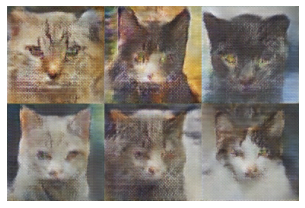

Epoch 50 | Discriminator loss: 0.1537252346432625 | Generator loss: 5.998284516312321



Epoch 51 | Discriminator loss: 0.20329172009501878 | Generator loss: 6.383047822932279



Epoch 52 | Discriminator loss: 0.17086099304893151 | Generator loss: 6.28537968458226



Epoch 53 | Discriminator loss: 0.1783635074249083 | Generator loss: 6.186304843520329



Epoch 54 | Discriminator loss: 0.18855988732702925 | Generator loss: 5.990232430629849



Epoch 55 | Discriminator loss: 0.17976327888215587 | Generator loss: 5.993560926352414



Epoch 56 | Discriminator loss: 0.15859332714451463 | Generator loss: 6.0047045202914235



Epoch 57 | Discriminator loss: 0.1734044772664889 | Generator loss: 6.434359954380841



Epoch 58 | Discriminator loss: 0.1874072098468959 | Generator loss: 6.173027835462404



Epoch 59 | Discriminator loss: 0.1734271053134397 | Generator loss: 5.963938047059505


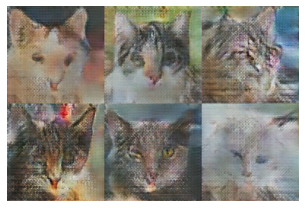

Epoch 60 | Discriminator loss: 0.1949650296741457 | Generator loss: 6.138639391070197



Epoch 61 | Discriminator loss: 0.1486582552857924 | Generator loss: 6.672142438451696



Epoch 62 | Discriminator loss: 0.16934059716759572 | Generator loss: 6.318178859417853



Epoch 63 | Discriminator loss: 0.1290970562159091 | Generator loss: 6.642265264106833



Epoch 64 | Discriminator loss: 0.14059881559458745 | Generator loss: 6.840107580056842



Epoch 65 | Discriminator loss: 0.14011346025783766 | Generator loss: 7.113752384965094



Epoch 66 | Discriminator loss: 0.14548449555582424 | Generator loss: 6.892633399654249



Epoch 67 | Discriminator loss: 0.13474431489472757 | Generator loss: 7.04989802013643



Epoch 68 | Discriminator loss: 0.14638953812554883 | Generator loss: 6.7766286477168896



Epoch 69 | Discriminator loss: 0.16918928441634856 | Generator loss: 6.966120091747053


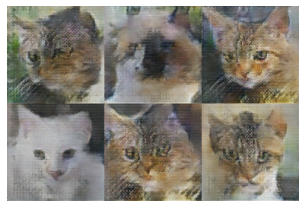

Epoch 70 | Discriminator loss: 0.1407643922041922 | Generator loss: 6.311854549774738



Epoch 71 | Discriminator loss: 0.15002812799691495 | Generator loss: 6.751888507959774



Epoch 72 | Discriminator loss: 0.125891624572492 | Generator loss: 6.678898756270823



Epoch 73 | Discriminator loss: 0.09971437254113916 | Generator loss: 7.090273626842854



Epoch 74 | Discriminator loss: 0.15065439263758373 | Generator loss: 7.798777614968904



Epoch 75 | Discriminator loss: 0.12194495549038861 | Generator loss: 7.073692829689439



Epoch 76 | Discriminator loss: 0.12850548604612455 | Generator loss: 7.277272255292961



Epoch 77 | Discriminator loss: 0.15148030303263746 | Generator loss: 7.066286876843953



Epoch 78 | Discriminator loss: 0.14324892288792151 | Generator loss: 6.7623299394982945



Epoch 79 | Discriminator loss: 0.13528057767043405 | Generator loss: 7.0331308472415675


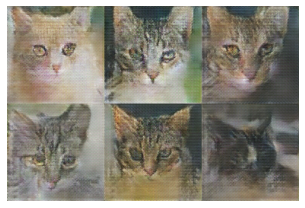

Epoch 80 | Discriminator loss: 0.15558614984665448 | Generator loss: 6.8214599840250445



Epoch 81 | Discriminator loss: 0.12744396574959008 | Generator loss: 6.787938910611668



Epoch 82 | Discriminator loss: 0.14515425049348232 | Generator loss: 6.854761337965542



Epoch 83 | Discriminator loss: 0.13221964649441376 | Generator loss: 7.027141871532391



Epoch 84 | Discriminator loss: 0.14665968609389665 | Generator loss: 7.147178712561264



Epoch 85 | Discriminator loss: 0.12480945201606368 | Generator loss: 6.871465526127852



Epoch 86 | Discriminator loss: 0.127280458054721 | Generator loss: 6.818463501028763



Epoch 87 | Discriminator loss: 0.15204473691062606 | Generator loss: 7.232767714661841



Epoch 88 | Discriminator loss: 0.11244164157963868 | Generator loss: 7.006138255461033



Epoch 89 | Discriminator loss: 0.1001544681081142 | Generator loss: 7.29089859984121


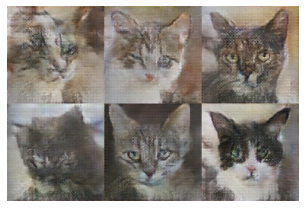

Epoch 90 | Discriminator loss: 0.12842672189305432 | Generator loss: 7.1411450112597175



Epoch 91 | Discriminator loss: 0.10096827504920694 | Generator loss: 7.195619924861637



Epoch 92 | Discriminator loss: 0.13917072722122473 | Generator loss: 7.341499986346834



Epoch 93 | Discriminator loss: 0.10679349819129544 | Generator loss: 7.66933678618129



Epoch 94 | Discriminator loss: 0.1215719411995468 | Generator loss: 7.4966070385915895



Epoch 95 | Discriminator loss: 0.09700681559953735 | Generator loss: 7.718939662905213



Epoch 96 | Discriminator loss: 0.12811730624995374 | Generator loss: 7.580707919940075



Epoch 97 | Discriminator loss: 0.16166188114029725 | Generator loss: 7.070017791682889



Epoch 98 | Discriminator loss: 0.11249003216314342 | Generator loss: 6.852949528960708



Epoch 99 | Discriminator loss: 0.09172498153281734 | Generator loss: 7.549793834364192


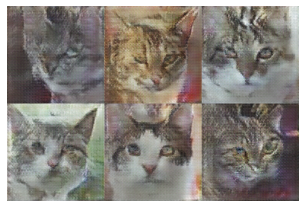

Epoch 100 | Discriminator loss: 0.09750007147314742 | Generator loss: 7.574609718245009



Epoch 101 | Discriminator loss: 0.1100555634147301 | Generator loss: 7.370573624968529



Epoch 102 | Discriminator loss: 0.11980596643961701 | Generator loss: 7.649410210411001



Epoch 103 | Discriminator loss: 0.11846360203152935 | Generator loss: 7.568933147913921



Epoch 104 | Discriminator loss: 0.1084053521448614 | Generator loss: 7.5916660447020705



Epoch 105 | Discriminator loss: 0.13994257888346853 | Generator loss: 7.230956260360754



Epoch 106 | Discriminator loss: 0.13610820830903786 | Generator loss: 6.875173723614364



Epoch 107 | Discriminator loss: 0.1365479942284251 | Generator loss: 7.071126585143693



Epoch 108 | Discriminator loss: 0.11214859694835616 | Generator loss: 7.5235757562129395



Epoch 109 | Discriminator loss: 0.07296832788641457 | Generator loss: 7.458390585013798


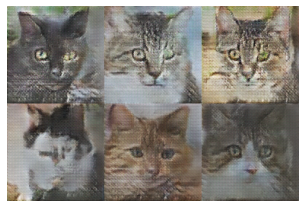

Epoch 110 | Discriminator loss: 0.10576318389313503 | Generator loss: 8.205629811616419



Epoch 111 | Discriminator loss: 0.08824302826976432 | Generator loss: 8.294294319722963



Epoch 112 | Discriminator loss: 0.09124080852193028 | Generator loss: 7.585521042485785



Epoch 113 | Discriminator loss: 0.0998501316973653 | Generator loss: 7.808868364054964



Epoch 114 | Discriminator loss: 0.1155424776276826 | Generator loss: 7.824417604376441



Epoch 115 | Discriminator loss: 0.10580957606236353 | Generator loss: 7.289793872222397



Epoch 116 | Discriminator loss: 0.11655729472158861 | Generator loss: 7.7945957382828555



Epoch 117 | Discriminator loss: 0.11857272947294095 | Generator loss: 7.426289233353035



Epoch 118 | Discriminator loss: 0.06882329888883046 | Generator loss: 7.707328982604957



Epoch 119 | Discriminator loss: 0.06624189951573455 | Generator loss: 7.962949414685461


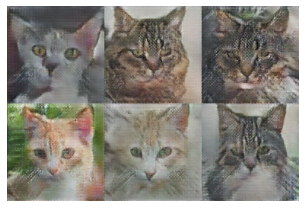

Epoch 120 | Discriminator loss: 0.1299444645175982 | Generator loss: 8.03548382379994


In [ ]:
train_gan()

### Задание 3 (5 баллов)
Теперь посмотрим на другую модель: Variational Autoencoder. В отличии от GAN, в котором генератор пытается себя обмануть дискриминатор, а дискриминатор старается не быть обманутым, VAE решает задачу реконструкции элемента множества X с применением регуляризации в латентном пространстве. 

Полностью архитектура выглядит так:
![](imgs/VAE.png)

Из нее можно выделить две части: Encoder (по изображению возвращает mu и sigma) и Decoder (по случайному шуму восстанавливает изображение). На высоком уровне VAE можно представить так:

![](imgs/VAE_highlevel.png)

В данном задании вам необходимо реализовать полную архитектуру VAE.

#### Методы
* `__init__` - принимает на вход `img_size`, `downsamplings`, `latent_size`, `linear_hidden_size`, `down_channels` и `up_channels`. `img_size` - размер стороны входного изображения. `downsamplings` - количество downsampling (и upsampling) блоков. `latent_size` - размер латентного пространства, в котором в который будет закодирована картинка. `linear_hidden_size` количество нейронов на скрытом слое полносвязной сети в конце encoder'а. Для полносвязной сети decoder'а это число стоит умножить на 2. `down_channels` - количество каналов, в которое будет преобразовано трехцветное изображение перед применением `downsampling` блоков. `up_channels` - количество каналов, которое должно получиться после применения всех upsampling блоков.

* `forward` - принимает на вход `x`. Считает распределение $N(\mu, \sigma^2)$ и вектор $z \sim N(\mu, \sigma^2)$. Возвращает $x'$ - восстановленную из вектора $z$ картинку и $D_{KL}(N(\mu, \sigma^2), N(0, 1)) = 0.5 \cdot (\sigma^2 + \mu^2 - \log \sigma^2 - 1)$.

* `encode` - принимает на вход `x`. Возвращает вектор из распределения $N(\mu, \sigma^2)$.

* `decode` - принимает на вход `z`. Возвращает восстановленную по вектору картинку.


#### Если хочется улучшить качество
https://arxiv.org/pdf/1906.00446.pdf

In [ ]:
from math import log2

In [ ]:
class Encoder(nn.Module):
    def __init__(self, img_size=128, latent_size=512, down_channels=8):
        super().__init__()
        downsamplings = int(log2(img_size))
        self.conv1 = nn.Conv2d(3, down_channels, 1, 1, 0)

        downsampling_blocks, in_channels = [], down_channels 
        for _ in range(downsamplings):
            downsampling_blocks.append(
                nn.Sequential(
                    nn.Conv2d(in_channels, in_channels * 2, 3, 2, 1),
                    nn.BatchNorm2d(in_channels * 2),
                    nn.ReLU()
                )
            )
            in_channels *= 2

        self.downsampling_blocks = nn.Sequential(*downsampling_blocks)
        self.conv2 = nn.Conv2d(in_channels, 2 * latent_size, 1, 1, 0)

    def forward(self, x):
        x = self.conv1(x)
        x = self.downsampling_blocks(x)
        x = self.conv2(x)
        self.mu, self.logvar = x.split(x.size(1) // 2, dim=1)
        std = torch.exp(0.5 * self.logvar)
        normals = torch.randn_like(self.mu).cuda()
        return self.mu + normals * std

class Decoder(nn.Module):
    def __init__(self, img_size=128, latent_size=512, up_channels=16):
        super().__init__()
        upsamplings = int(log2(img_size))
        self.conv1 = nn.Conv2d(latent_size, up_channels * (2 ** upsamplings), 1, 1, 0)

        upsampling_blocks, in_channels = [], up_channels * (2 ** upsamplings)
        for _ in range(upsamplings):
            upsampling_blocks.append(
                nn.Sequential(
                    nn.ConvTranspose2d(in_channels, in_channels // 2, 4, 2, 1),
                    nn.BatchNorm2d(in_channels // 2),
                    nn.ReLU()
                )
            )
            in_channels //= 2

        self.upsampling_blocks = nn.Sequential(*upsampling_blocks)
        self.conv2 = nn.Conv2d(in_channels, 3, 1, 1, 0)

    def forward(self, x):
        x = self.conv1(x)
        x = self.upsampling_blocks(x)
        x = torch.tanh(self.conv2(x))
        return x

In [ ]:
class VAE(nn.Module):
    def __init__(self, img_size=128, downsamplings=5, latent_size=512, linear_hidden_size=1024, down_channels=8, up_channels=16):
        super().__init__()
        self.encoder = Encoder(img_size, latent_size, down_channels)
        self.decoder = Decoder(img_size, latent_size, up_channels)
        
    def forward(self, x):
        z = self.encode(x)
        x_pred = self.decode(z)
        mu, logvar = self.encoder.mu, self.encoder.logvar
        kld = 0.5 * (torch.exp(logvar) + mu ** 2 - logvar - 1)
        return x_pred, kld
    
    def encode(self, x):
        return self.encoder(x)
    
    def decode(self, z):
        return self.decoder(z)

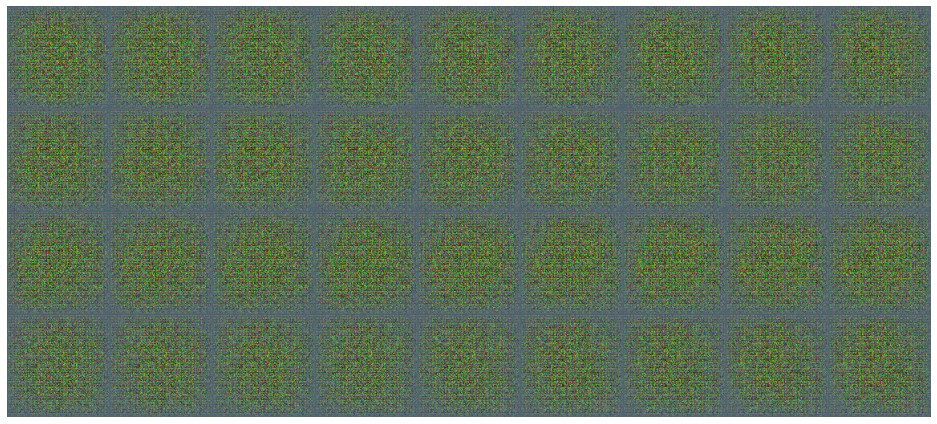

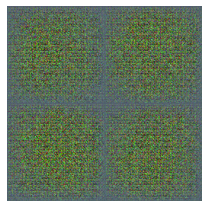


Epoch 1 | Reconstruction loss: 8912.243990501262 | KLD loss: 193.02601961171405



Epoch 2 | Reconstruction loss: 6718.125165666853 | KLD loss: 323.74585700183184



Epoch 3 | Reconstruction loss: 6334.029439037631 | KLD loss: 407.1223569123641



Epoch 4 | Reconstruction loss: 5979.169828995415 | KLD loss: 469.89854336377255



Epoch 5 | Reconstruction loss: 5755.224877398947 | KLD loss: 512.7323501776464



Epoch 6 | Reconstruction loss: 5612.6661801545515 | KLD loss: 544.6584833275457



Epoch 7 | Reconstruction loss: 5443.413179954387 | KLD loss: 568.2005455064477



Epoch 8 | Reconstruction loss: 5314.161618060947 | KLD loss: 599.1742786857652



Epoch 9 | Reconstruction loss: 5169.576632481924 | KLD loss: 614.2299169694414



Epoch 10 | Reconstruction loss: 5016.608685795565 | KLD loss: 631.7116129620475


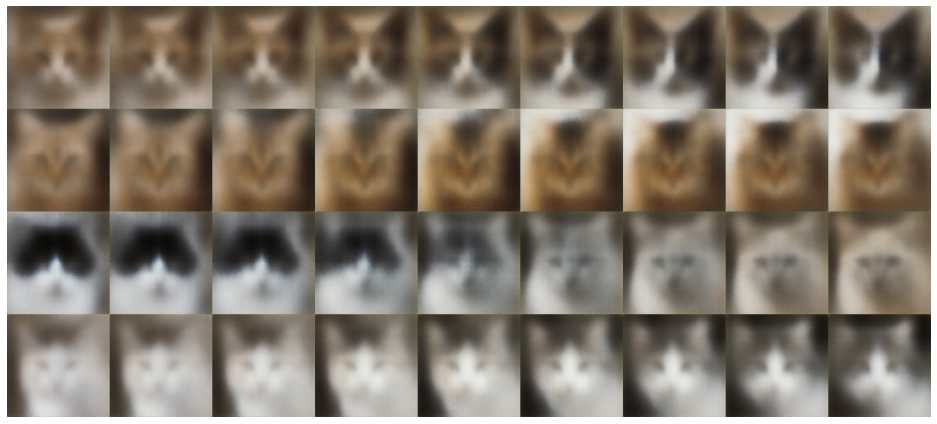

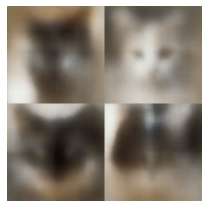


Epoch 11 | Reconstruction loss: 4964.693941294036 | KLD loss: 649.5784813543285



Epoch 12 | Reconstruction loss: 4845.024997118838 | KLD loss: 650.1467154366629



Epoch 13 | Reconstruction loss: 4727.667973299204 | KLD loss: 659.1342903279369



Epoch 14 | Reconstruction loss: 4667.136153890479 | KLD loss: 662.1769027236086



Epoch 15 | Reconstruction loss: 4613.796349187815 | KLD loss: 665.7189631491715



Epoch 16 | Reconstruction loss: 4526.270550650839 | KLD loss: 670.8518623683764



Epoch 17 | Reconstruction loss: 4459.906118452179 | KLD loss: 678.5077475790652



Epoch 18 | Reconstruction loss: 4367.943456045589 | KLD loss: 684.8881681454108



Epoch 19 | Reconstruction loss: 4328.6115529315075 | KLD loss: 693.5187367504428



Epoch 20 | Reconstruction loss: 4281.869818835525 | KLD loss: 698.6864134036236


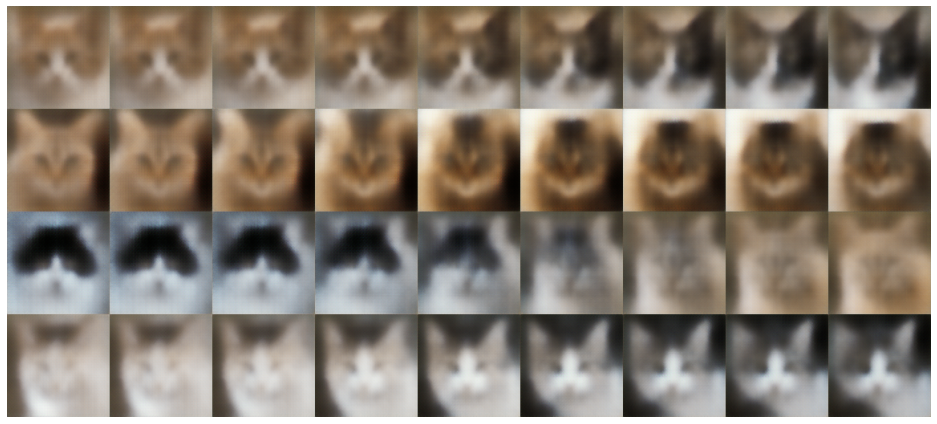

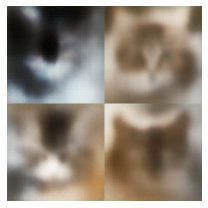


Epoch 21 | Reconstruction loss: 4193.921724118061 | KLD loss: 703.863223816297



Epoch 22 | Reconstruction loss: 4184.69191576087 | KLD loss: 702.6934217370075



Epoch 23 | Reconstruction loss: 4136.775280685899 | KLD loss: 711.3925641930622



Epoch 24 | Reconstruction loss: 4104.584823703173 | KLD loss: 708.2732380932163



Epoch 25 | Reconstruction loss: 4045.699412091178 | KLD loss: 710.842723585804



Epoch 26 | Reconstruction loss: 4024.975405864834 | KLD loss: 719.1996962268901



Epoch 27 | Reconstruction loss: 3987.0642889745486 | KLD loss: 721.9914860695785



Epoch 28 | Reconstruction loss: 3963.447621600228 | KLD loss: 724.767036674926



Epoch 29 | Reconstruction loss: 3919.2562839673915 | KLD loss: 729.6123778538674



Epoch 30 | Reconstruction loss: 3898.8813294594333 | KLD loss: 729.5681810082856


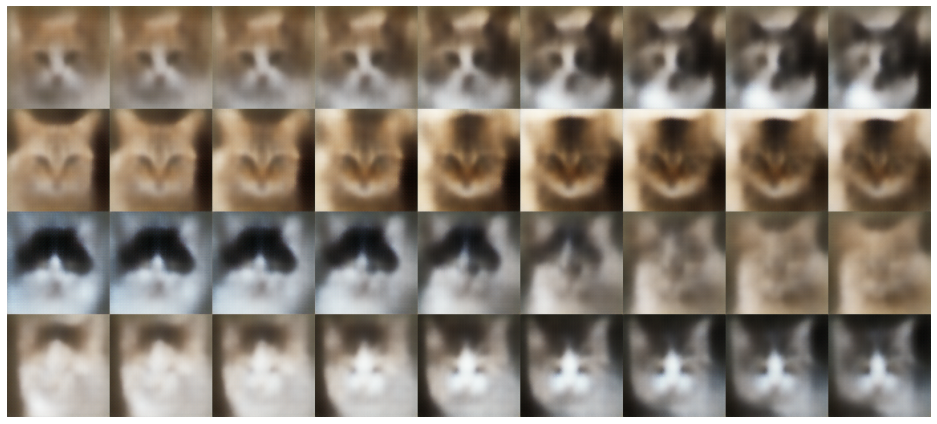

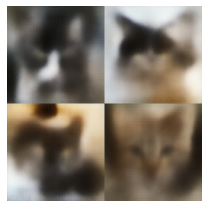


Epoch 31 | Reconstruction loss: 3860.792373941552 | KLD loss: 734.3209840762689



Epoch 32 | Reconstruction loss: 3821.7739890910084 | KLD loss: 731.9448854434564



Epoch 33 | Reconstruction loss: 3809.768209327082 | KLD loss: 739.5599388928147



Epoch 34 | Reconstruction loss: 3750.5511076554008 | KLD loss: 739.4972924653048



Epoch 35 | Reconstruction loss: 3745.2779343883444 | KLD loss: 743.3460065000546



Epoch 36 | Reconstruction loss: 3721.4489844659843 | KLD loss: 745.8280179041514



Epoch 37 | Reconstruction loss: 3701.460890870657 | KLD loss: 745.4875451318966



Epoch 38 | Reconstruction loss: 3698.147073496943 | KLD loss: 747.2223315505507



Epoch 39 | Reconstruction loss: 3642.9806135663334 | KLD loss: 746.633229131284



Epoch 40 | Reconstruction loss: 3642.671568686918 | KLD loss: 747.9471374890819


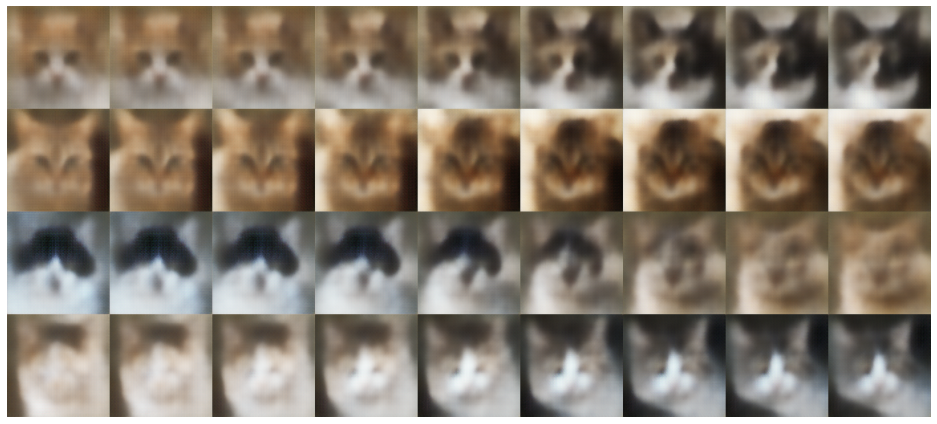

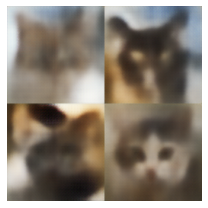


Epoch 41 | Reconstruction loss: 3618.184257933812 | KLD loss: 752.8853901928256



Epoch 42 | Reconstruction loss: 3575.4745642620583 | KLD loss: 751.2440784525427



Epoch 43 | Reconstruction loss: 3573.523802952737 | KLD loss: 749.984906783015



Epoch 44 | Reconstruction loss: 3555.6780672251066 | KLD loss: 754.538732587921



Epoch 45 | Reconstruction loss: 3539.8010735363696 | KLD loss: 755.4129968489179



Epoch 46 | Reconstruction loss: 3520.5213842925077 | KLD loss: 758.6164262664985



Epoch 47 | Reconstruction loss: 3506.7960538686434 | KLD loss: 757.8913228289681



Epoch 48 | Reconstruction loss: 3466.059093783361 | KLD loss: 756.5811863300963



Epoch 49 | Reconstruction loss: 3454.856937005653 | KLD loss: 759.2211669542775



Epoch 50 | Reconstruction loss: 3451.997665120948 | KLD loss: 761.1216092317001


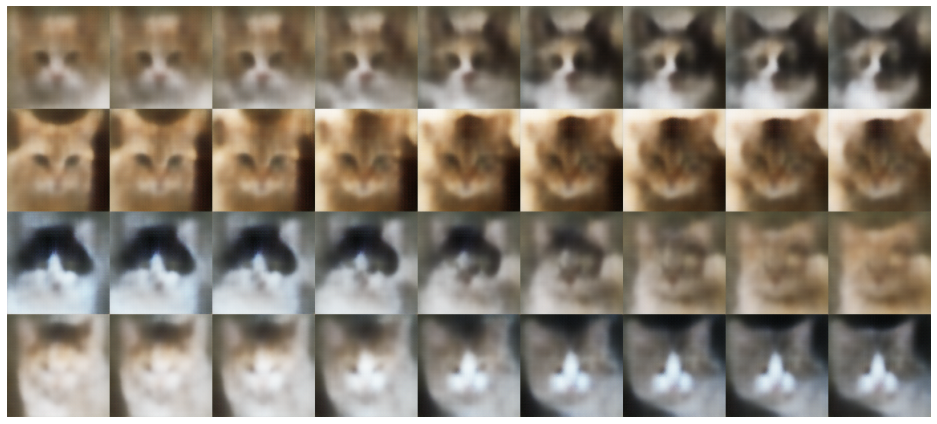

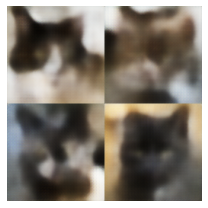


Epoch 51 | Reconstruction loss: 3417.4011522376018 | KLD loss: 762.6275160890189



Epoch 52 | Reconstruction loss: 3405.764505137568 | KLD loss: 762.3130514962332



Epoch 53 | Reconstruction loss: 3388.323023446598 | KLD loss: 762.8177933781784



Epoch 54 | Reconstruction loss: 3366.0779354498254 | KLD loss: 759.0866925731209



Epoch 55 | Reconstruction loss: 3360.5568081873544 | KLD loss: 759.7162903021581



Epoch 56 | Reconstruction loss: 3332.0800625818856 | KLD loss: 763.6272709058678



Epoch 57 | Reconstruction loss: 3324.00806232713 | KLD loss: 761.0858042462272



Epoch 58 | Reconstruction loss: 3305.3445957728795 | KLD loss: 763.5165809015309



Epoch 59 | Reconstruction loss: 3306.236592737044 | KLD loss: 764.1987441163626



Epoch 60 | Reconstruction loss: 3278.0416074006453 | KLD loss: 762.0570762113015


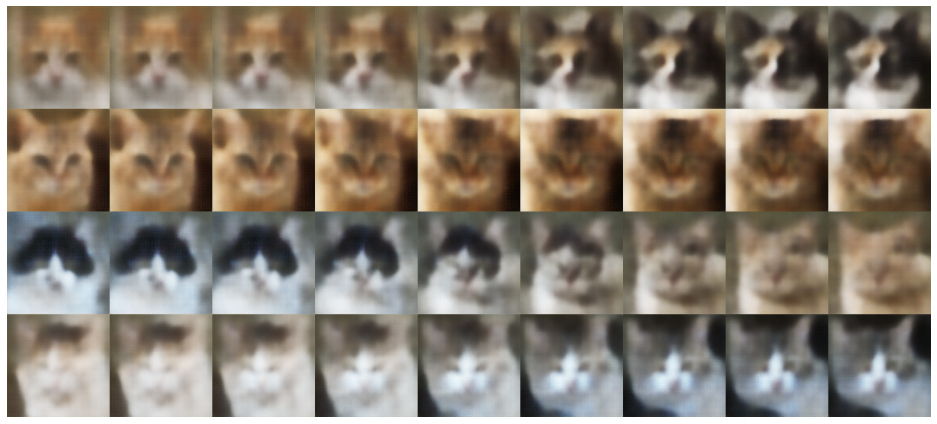

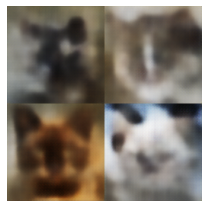


Epoch 61 | Reconstruction loss: 3280.3525875873447 | KLD loss: 765.5900475164378



Epoch 62 | Reconstruction loss: 3236.138110616933 | KLD loss: 763.8338908319888



Epoch 63 | Reconstruction loss: 3235.833156230287 | KLD loss: 768.5462476836968



Epoch 64 | Reconstruction loss: 3224.870584997331 | KLD loss: 768.4077645058958



Epoch 65 | Reconstruction loss: 3223.8742179159794 | KLD loss: 763.2736042093786



Epoch 66 | Reconstruction loss: 3206.4632003499855 | KLD loss: 759.6011202794424



Epoch 67 | Reconstruction loss: 3182.96510419194 | KLD loss: 761.9743279877657



Epoch 68 | Reconstruction loss: 3157.820216966712 | KLD loss: 763.8782766590948



Epoch 69 | Reconstruction loss: 3164.4550595490828 | KLD loss: 758.9430608334749



Epoch 70 | Reconstruction loss: 3138.924737586738 | KLD loss: 760.2437486352387


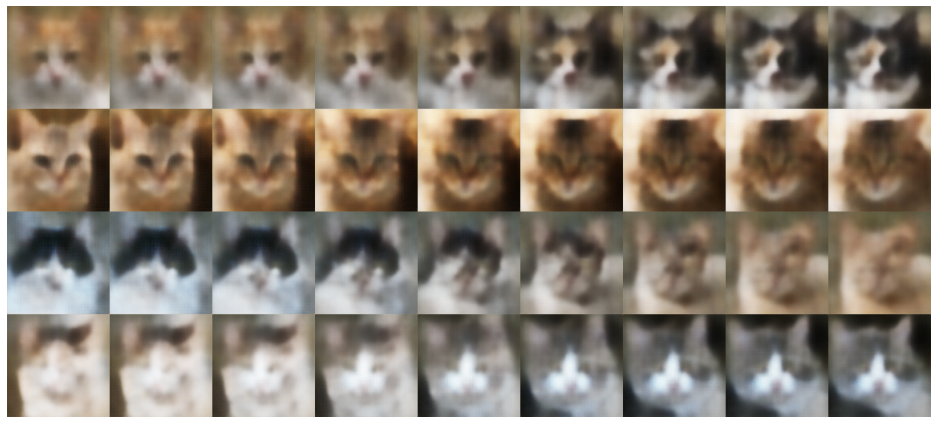

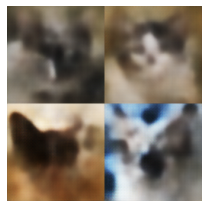


Epoch 71 | Reconstruction loss: 3140.7241339831617 | KLD loss: 762.986988896909



Epoch 72 | Reconstruction loss: 3139.0666636591372 | KLD loss: 765.1375052884499



Epoch 73 | Reconstruction loss: 3110.2325037606756 | KLD loss: 763.1505107998107



Epoch 74 | Reconstruction loss: 3105.9348976656515 | KLD loss: 764.0343222292314



Epoch 75 | Reconstruction loss: 3084.6763019443297 | KLD loss: 759.3505739010639



Epoch 76 | Reconstruction loss: 3076.1193233513686 | KLD loss: 761.9058257867091



Epoch 77 | Reconstruction loss: 3056.0523431434394 | KLD loss: 759.793986634438



Epoch 78 | Reconstruction loss: 3063.7346767638783 | KLD loss: 761.8887302564538



Epoch 79 | Reconstruction loss: 3041.5925744098167 | KLD loss: 760.1363614479208



Epoch 80 | Reconstruction loss: 3031.7707720454437 | KLD loss: 759.950358041325


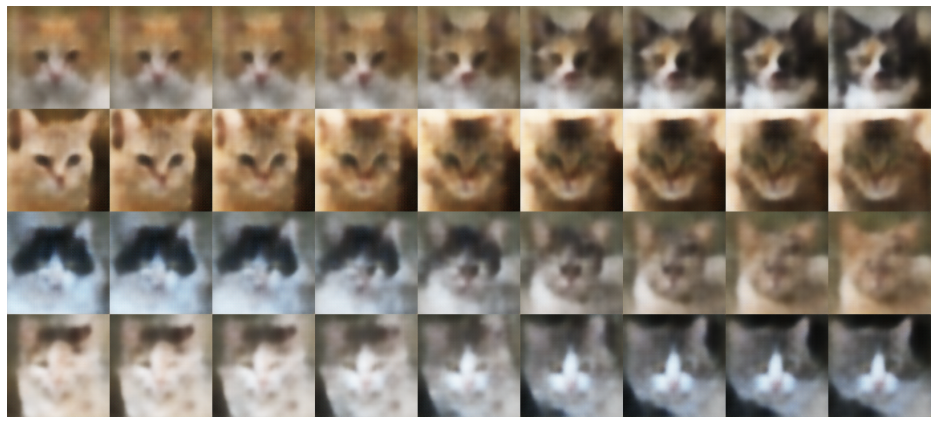

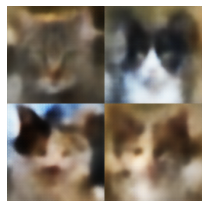


Epoch 81 | Reconstruction loss: 3027.869959671305 | KLD loss: 761.538725100689



Epoch 82 | Reconstruction loss: 3012.27483751759 | KLD loss: 764.9842108495487



Epoch 83 | Reconstruction loss: 3006.6915258561603 | KLD loss: 758.8684380572776



Epoch 84 | Reconstruction loss: 2999.936021319087 | KLD loss: 760.7339787453598



Epoch 85 | Reconstruction loss: 2982.8094787597656 | KLD loss: 758.5934185715196



Epoch 86 | Reconstruction loss: 2963.3932811665977 | KLD loss: 755.9582688230905



Epoch 87 | Reconstruction loss: 2959.1947476404794 | KLD loss: 758.1556373738354



Epoch 88 | Reconstruction loss: 2956.3979628663624 | KLD loss: 757.5915926346868



Epoch 89 | Reconstruction loss: 2934.016288046511 | KLD loss: 756.4290330780219



Epoch 90 | Reconstruction loss: 2942.5013223020187 | KLD loss: 753.3472446417957


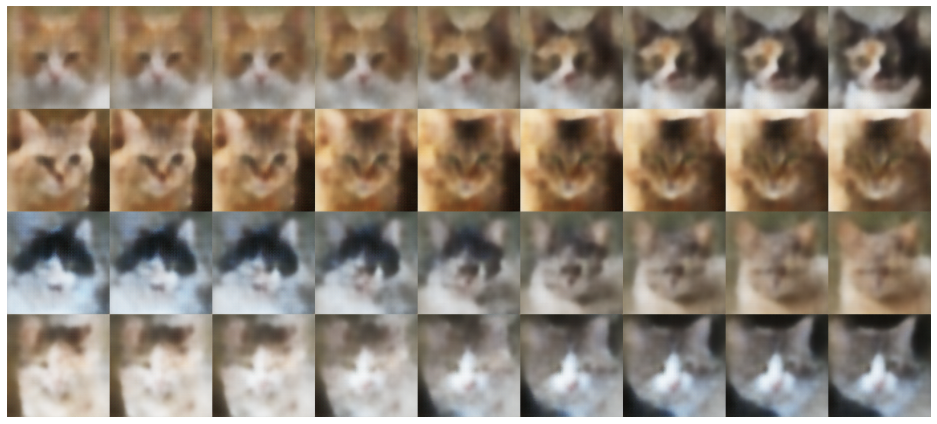

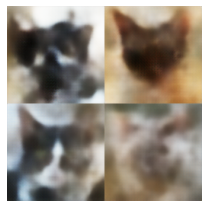


Epoch 91 | Reconstruction loss: 2931.792356692486 | KLD loss: 754.5786063626687



Epoch 92 | Reconstruction loss: 2921.429529983805 | KLD loss: 751.9193031832298



Epoch 93 | Reconstruction loss: 2897.9836044785397 | KLD loss: 754.1467994073903



Epoch 94 | Reconstruction loss: 2901.044904436384 | KLD loss: 755.2003007023972



Epoch 95 | Reconstruction loss: 2902.907973011088 | KLD loss: 754.0526470871446



Epoch 96 | Reconstruction loss: 2871.2735868655377 | KLD loss: 755.0015259736813



Epoch 97 | Reconstruction loss: 2880.827824373423 | KLD loss: 754.0111661164657



Epoch 98 | Reconstruction loss: 2863.5287949461376 | KLD loss: 750.888987665591



Epoch 99 | Reconstruction loss: 2849.4226783136405 | KLD loss: 751.1121504884329



Epoch 100 | Reconstruction loss: 2843.9931049228453 | KLD loss: 747.8721510608744


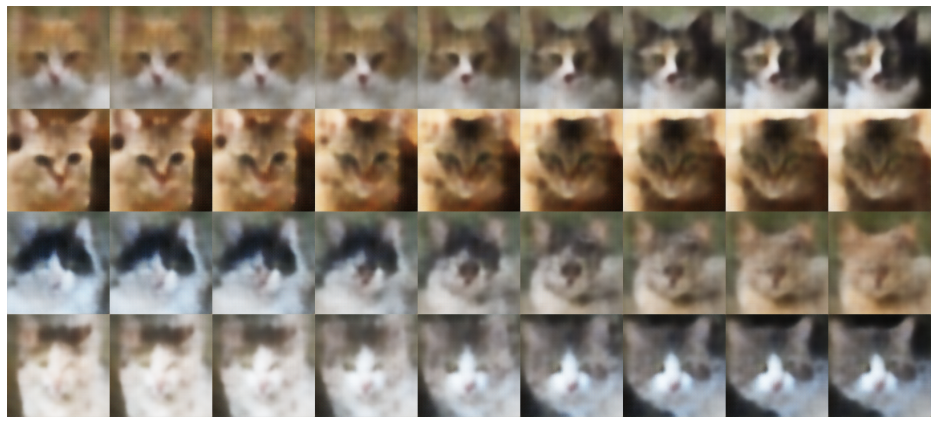

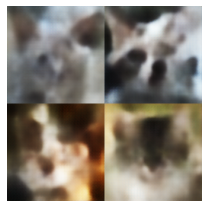


Epoch 101 | Reconstruction loss: 2841.4344740210113 | KLD loss: 747.6182718217743



Epoch 102 | Reconstruction loss: 2835.304258927055 | KLD loss: 747.3428719088157



Epoch 103 | Reconstruction loss: 2824.7304823976124 | KLD loss: 748.7963394259814



Epoch 104 | Reconstruction loss: 2821.1637927701013 | KLD loss: 747.0430844703817



Epoch 105 | Reconstruction loss: 2804.8786412588556 | KLD loss: 747.3464017121688



Epoch 106 | Reconstruction loss: 2815.0479203692134 | KLD loss: 742.9829344186724



Epoch 107 | Reconstruction loss: 2783.324084169376 | KLD loss: 744.1066130644047



Epoch 108 | Reconstruction loss: 2777.4273461762423 | KLD loss: 742.226918380453



Epoch 109 | Reconstruction loss: 2770.316910643015 | KLD loss: 741.3211291769277



Epoch 110 | Reconstruction loss: 2761.0705670658845 | KLD loss: 740.0083703461642


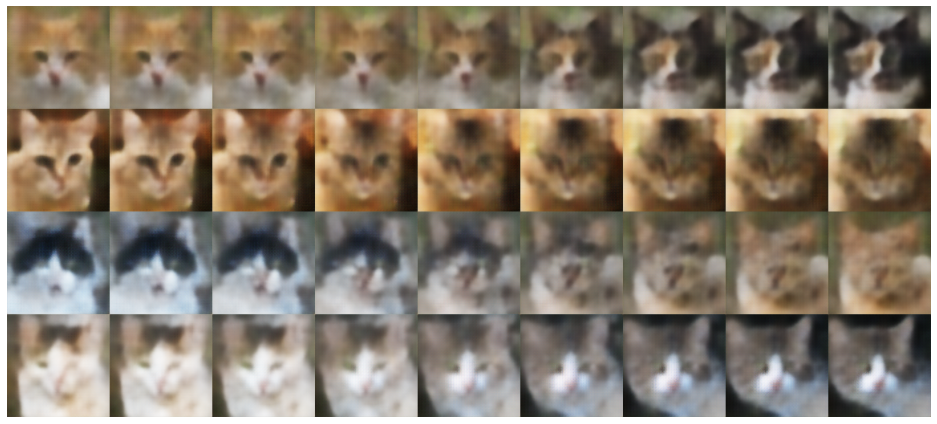

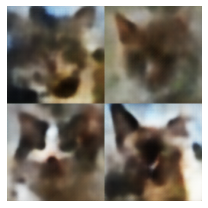


Epoch 111 | Reconstruction loss: 2740.918835373399 | KLD loss: 741.2717814001237



Epoch 112 | Reconstruction loss: 2754.7495035680927 | KLD loss: 740.1034670053801



Epoch 113 | Reconstruction loss: 2744.913728323042 | KLD loss: 739.4283030255241



Epoch 114 | Reconstruction loss: 2734.404602808982 | KLD loss: 739.5978372704168



Epoch 115 | Reconstruction loss: 2718.182347268051 | KLD loss: 737.6897453165943



Epoch 116 | Reconstruction loss: 2725.6246025132837 | KLD loss: 736.203996267378



Epoch 117 | Reconstruction loss: 2723.6445589243253 | KLD loss: 737.3585127362553



Epoch 118 | Reconstruction loss: 2680.587303777659 | KLD loss: 737.9289919456339



Epoch 119 | Reconstruction loss: 2698.1507719999513 | KLD loss: 732.7450047842464



Epoch 120 | Reconstruction loss: 2687.146902333135 | KLD loss: 729.5051343455818


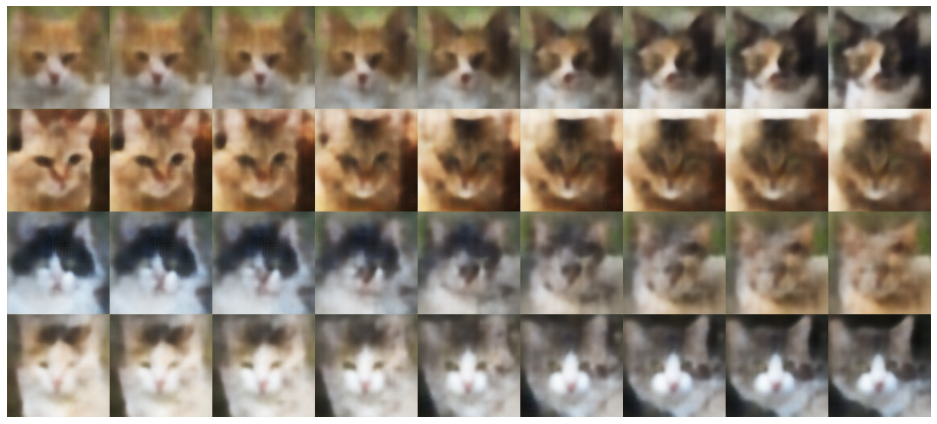

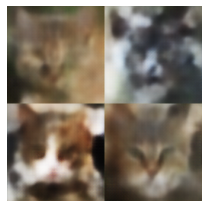


Epoch 121 | Reconstruction loss: 2688.5208677682817 | KLD loss: 735.835212660132



Epoch 122 | Reconstruction loss: 2688.6833490407244 | KLD loss: 734.7547695562706



Epoch 123 | Reconstruction loss: 2683.0589825174084 | KLD loss: 731.6230868700868



Epoch 124 | Reconstruction loss: 2661.962079350252 | KLD loss: 728.9722512760518



Epoch 125 | Reconstruction loss: 2665.3904011412437 | KLD loss: 728.0504184509656



Epoch 126 | Reconstruction loss: 2647.3147636081862 | KLD loss: 726.4446044353225



Epoch 127 | Reconstruction loss: 2651.331571211726 | KLD loss: 727.0177805645866



Epoch 128 | Reconstruction loss: 2642.1450017135335 | KLD loss: 723.9478179742091



Epoch 129 | Reconstruction loss: 2635.0258914165615 | KLD loss: 728.5905141889679



Epoch 130 | Reconstruction loss: 2624.8768092564173 | KLD loss: 726.6277682855263


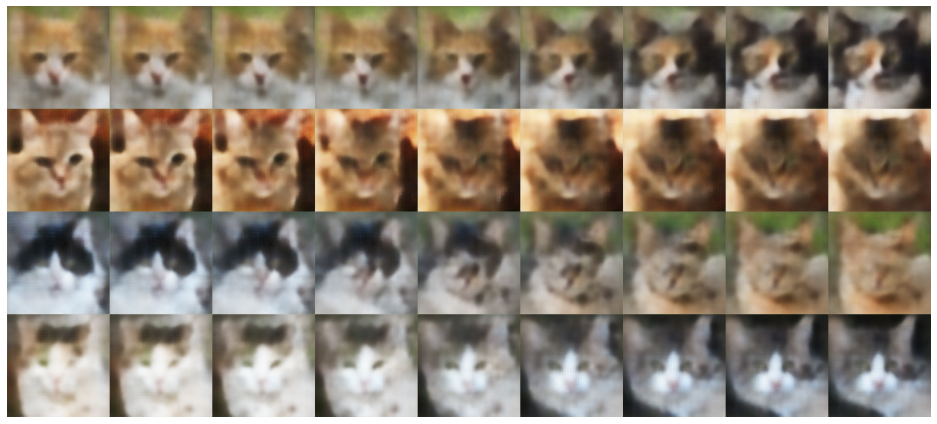

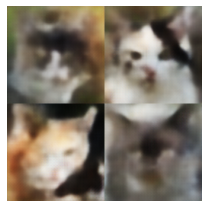


Epoch 131 | Reconstruction loss: 2611.716729584688 | KLD loss: 727.3062853131976



Epoch 132 | Reconstruction loss: 2608.0243060189005 | KLD loss: 722.6777137140309



Epoch 133 | Reconstruction loss: 2604.3940293211376 | KLD loss: 724.2635304705697



Epoch 134 | Reconstruction loss: 2606.3477330178207 | KLD loss: 720.3781555365331



Epoch 135 | Reconstruction loss: 2587.5011071625704 | KLD loss: 716.751085079975



Epoch 136 | Reconstruction loss: 2584.081520033179 | KLD loss: 721.1204712672263



Epoch 137 | Reconstruction loss: 2594.4156806898413 | KLD loss: 723.0627430033239



Epoch 138 | Reconstruction loss: 2573.6404432213826 | KLD loss: 716.2215916414439



Epoch 139 | Reconstruction loss: 2583.0241858440895 | KLD loss: 717.7480061217125



Epoch 140 | Reconstruction loss: 2565.808453861971 | KLD loss: 716.0289131306713


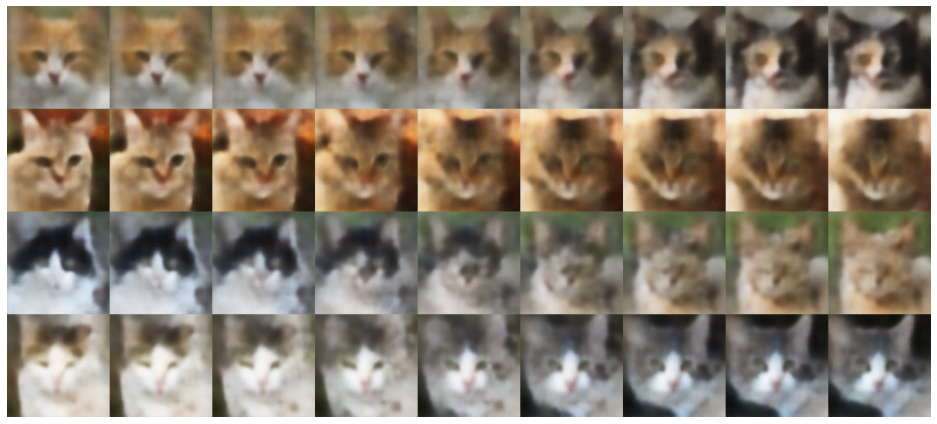

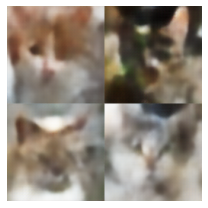


Epoch 141 | Reconstruction loss: 2560.2230336443977 | KLD loss: 712.7980689765503



Epoch 142 | Reconstruction loss: 2569.2278662261015 | KLD loss: 715.6157517522018



Epoch 143 | Reconstruction loss: 2550.2925959048066 | KLD loss: 713.0145714801291



Epoch 144 | Reconstruction loss: 2549.1931974991508 | KLD loss: 715.033038216348



Epoch 145 | Reconstruction loss: 2538.1677200601707 | KLD loss: 716.5595806429845



Epoch 146 | Reconstruction loss: 2530.380980687112 | KLD loss: 711.804747208305



Epoch 147 | Reconstruction loss: 2528.991548147261 | KLD loss: 710.9694654571343



Epoch 148 | Reconstruction loss: 2518.6619082622647 | KLD loss: 708.0383150088861



Epoch 149 | Reconstruction loss: 2528.867439980833 | KLD loss: 710.3127959825978



Epoch 150 | Reconstruction loss: 2512.373304094587 | KLD loss: 708.6293259140867


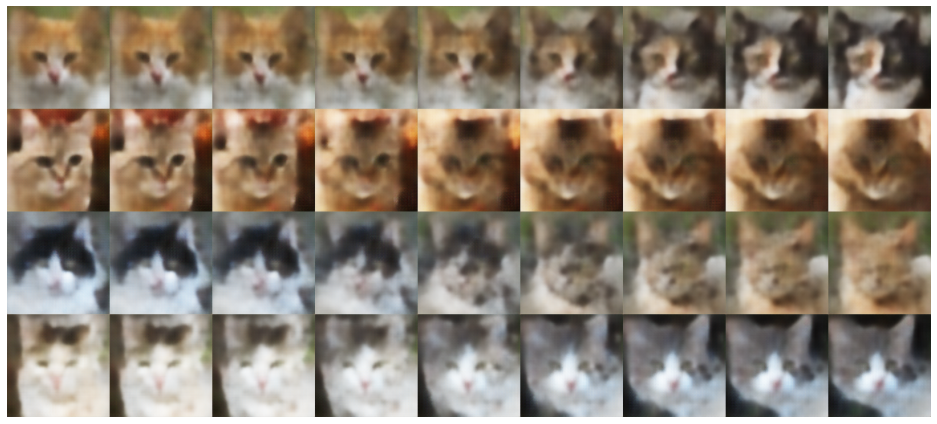

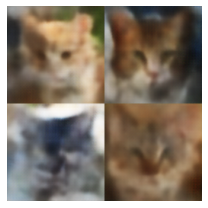


Epoch 151 | Reconstruction loss: 2511.854147016632 | KLD loss: 707.1546490592245



Epoch 152 | Reconstruction loss: 2502.640760528375 | KLD loss: 707.3778992646969



Epoch 153 | Reconstruction loss: 2499.7663168581375 | KLD loss: 705.1964498958232



Epoch 154 | Reconstruction loss: 2503.0250913252744 | KLD loss: 704.9589392620584



Epoch 155 | Reconstruction loss: 2494.084904641098 | KLD loss: 705.3045635341857



Epoch 156 | Reconstruction loss: 2482.3537394837563 | KLD loss: 704.6260210120159



Epoch 157 | Reconstruction loss: 2486.1270111273534 | KLD loss: 704.0735591153921



Epoch 158 | Reconstruction loss: 2472.3032630304374 | KLD loss: 700.0704049057101



Epoch 159 | Reconstruction loss: 2480.128788728892 | KLD loss: 700.2139611096115



Epoch 160 | Reconstruction loss: 2462.5091469332297 | KLD loss: 699.7817574258177


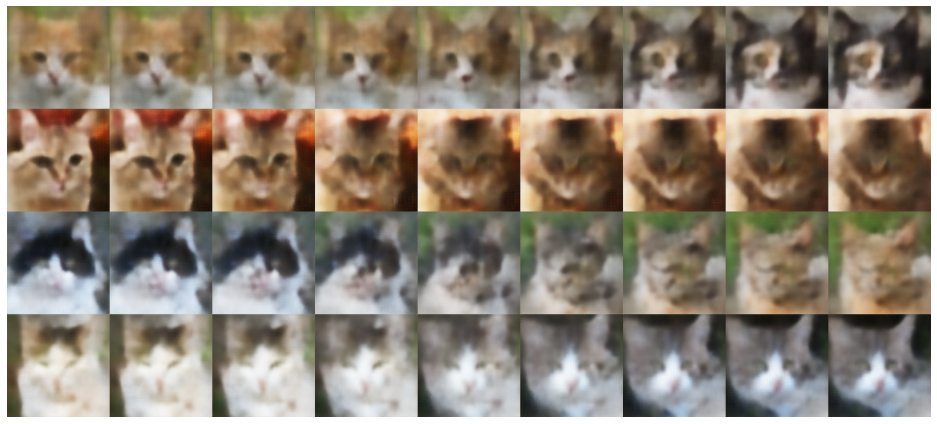

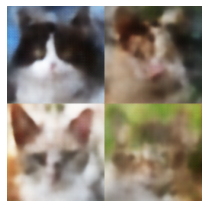


Epoch 161 | Reconstruction loss: 2471.333226553402 | KLD loss: 701.4449754797894



Epoch 162 | Reconstruction loss: 2455.1553282175005 | KLD loss: 697.0152175618995



Epoch 163 | Reconstruction loss: 2463.168316953671 | KLD loss: 697.5385896670892



Epoch 164 | Reconstruction loss: 2447.189099234824 | KLD loss: 694.1050318368474



Epoch 165 | Reconstruction loss: 2443.90726996949 | KLD loss: 695.6137155094502



Epoch 166 | Reconstruction loss: 2445.1124906362215 | KLD loss: 696.5513885687596



Epoch 167 | Reconstruction loss: 2435.007949923877 | KLD loss: 694.8363317643633



Epoch 168 | Reconstruction loss: 2422.309284091736 | KLD loss: 691.0823200296911



Epoch 169 | Reconstruction loss: 2443.2012929975617 | KLD loss: 692.1270826825444



Epoch 170 | Reconstruction loss: 2417.510942921135 | KLD loss: 691.807506490198


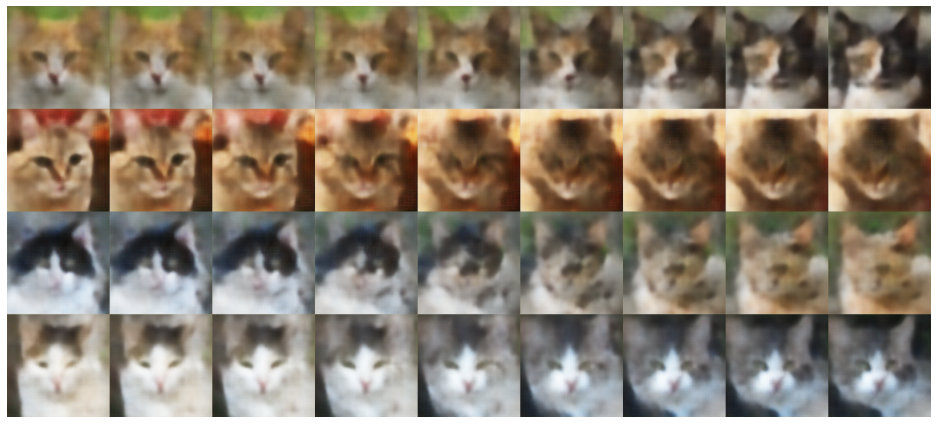

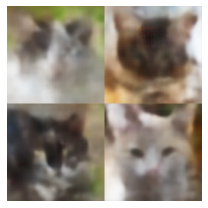


Epoch 171 | Reconstruction loss: 2421.730426859411 | KLD loss: 691.3473318348761



Epoch 172 | Reconstruction loss: 2413.8194889044908 | KLD loss: 689.6159973144531



Epoch 173 | Reconstruction loss: 2416.6973312093605 | KLD loss: 688.7213460791926



Epoch 174 | Reconstruction loss: 2403.5904497419083 | KLD loss: 687.4666098837527



Epoch 175 | Reconstruction loss: 2394.7828251619517 | KLD loss: 684.7840827325856



Epoch 176 | Reconstruction loss: 2403.785111895259 | KLD loss: 686.3086567754331



Epoch 177 | Reconstruction loss: 2391.4091050047314 | KLD loss: 685.6328258632873



Epoch 178 | Reconstruction loss: 2395.275353662716 | KLD loss: 683.9480407904393



Epoch 179 | Reconstruction loss: 2383.2313681655787 | KLD loss: 682.8466792136246



Epoch 180 | Reconstruction loss: 2378.554814498617 | KLD loss: 681.8452452665531


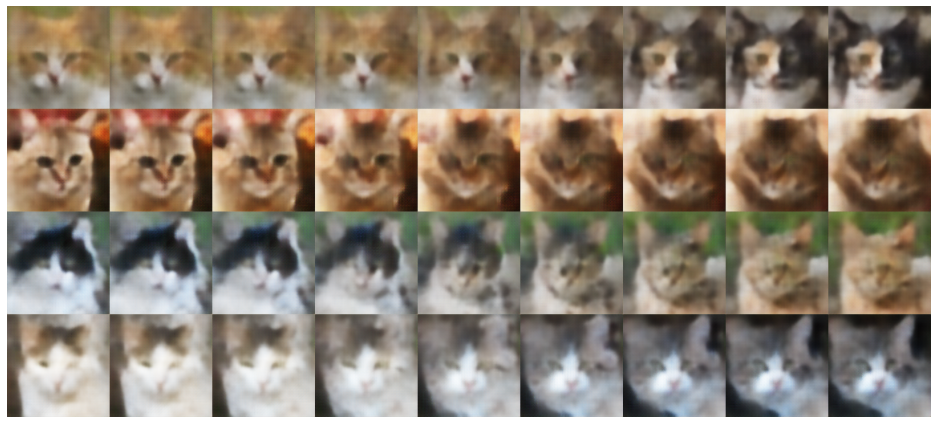

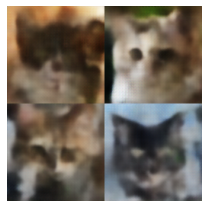


Epoch 181 | Reconstruction loss: 2376.5727106888103 | KLD loss: 683.5394707910763



Epoch 182 | Reconstruction loss: 2372.0590065902807 | KLD loss: 679.3605624370693



Epoch 183 | Reconstruction loss: 2370.4475514666633 | KLD loss: 677.8929502119929



Epoch 184 | Reconstruction loss: 2365.341421565654 | KLD loss: 677.9678093572581



Epoch 185 | Reconstruction loss: 2374.741516871482 | KLD loss: 679.1886200519822



Epoch 186 | Reconstruction loss: 2363.5135268691165 | KLD loss: 676.4444780053559



Epoch 187 | Reconstruction loss: 2367.2341354085793 | KLD loss: 678.0029368904067



Epoch 188 | Reconstruction loss: 2351.0470905185484 | KLD loss: 674.8629430924883



Epoch 189 | Reconstruction loss: 2351.984428453149 | KLD loss: 674.4699591405644



Epoch 190 | Reconstruction loss: 2351.7471051897323 | KLD loss: 675.1556486520708


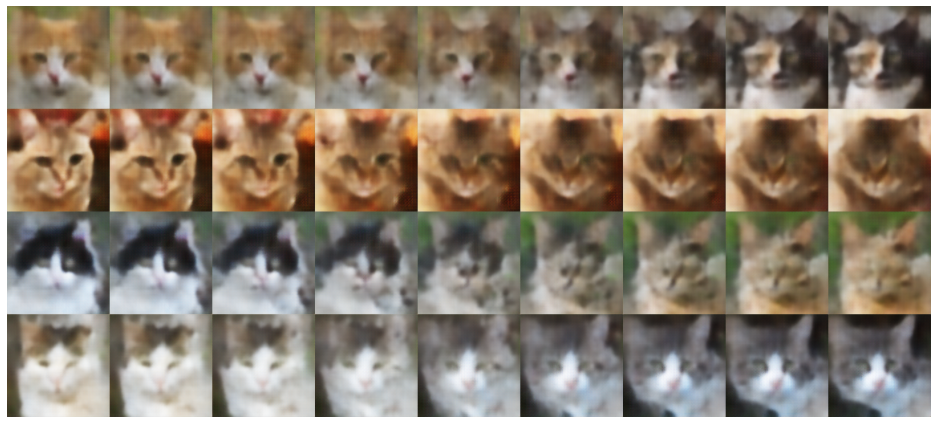

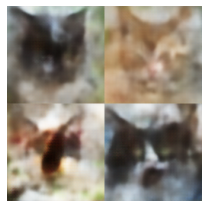


Epoch 191 | Reconstruction loss: 2345.4409954947714 | KLD loss: 675.6313120208172



Epoch 192 | Reconstruction loss: 2340.3331514915326 | KLD loss: 672.3522047907669



Epoch 193 | Reconstruction loss: 2342.2901834997333 | KLD loss: 671.6257504291416



Epoch 194 | Reconstruction loss: 2330.6688177452324 | KLD loss: 671.1645524872016



Epoch 195 | Reconstruction loss: 2329.9836270350106 | KLD loss: 670.2383737504853



Epoch 196 | Reconstruction loss: 2328.0721882885287 | KLD loss: 670.3041726817255



Epoch 197 | Reconstruction loss: 2317.683602090208 | KLD loss: 666.3275311393027



Epoch 198 | Reconstruction loss: 2320.6072683393586 | KLD loss: 663.9445070065326



Epoch 199 | Reconstruction loss: 2322.0985649535373 | KLD loss: 664.9546870829896



Epoch 200 | Reconstruction loss: 2317.803290894313 | KLD loss: 667.1646116268561


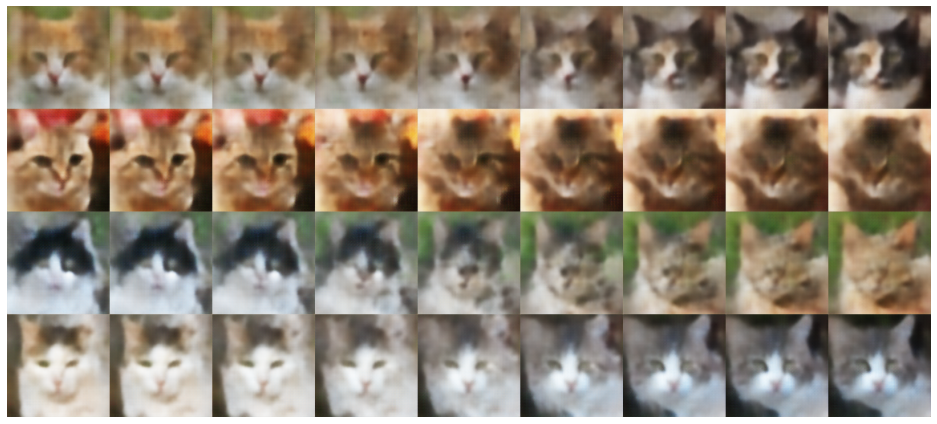

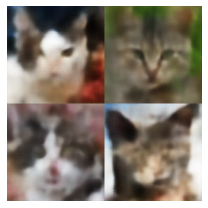


Epoch 201 | Reconstruction loss: 2309.5262961061844 | KLD loss: 665.4960016286151


In [ ]:
def train_vae():
    vae = VAE()
    vae.cuda()

    epochs = 201
    batch_size = 8
    vae_optim = Adam(vae.parameters(), lr=1e-4)

    dataset = CatDataset(size=128)

    test_imgs_1 = torch.cat([dataset[i].unsqueeze(0) for i in (0, 34, 76, 1509)])
    test_imgs_2 = torch.cat([dataset[i].unsqueeze(0) for i in (734, 123, 512, 3634)])

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        rec_loss_avg = 0
        kld_loss_avg = 0

        if ep % 10 == 0:
            with torch.no_grad():
                z_1 = vae.encode(test_imgs_1.cuda())
                z_2 = vae.encode(test_imgs_2.cuda())
                x_int = []
                for i in range(9):
                    z = (i * z_1 + (8 - i) * z_2) / 8
                    x_int.append(vae.decode(z))
                x_int = torch.cat(x_int)
                visualise(x_int, rows=len(test_imgs_1))
                z_rand = torch.randn_like(z_1)
                x_int = vae.decode(z_rand)
                visualise(x_int, rows=len(test_imgs_1)//2)

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            x = batch.cuda()
            x_rec, kld = vae(x)
            img_elems = float(np.prod(list(batch.size())))
            kld_loss = kld.sum() / batch_size
            rec_loss = ((x_rec - x)**2).sum() / batch_size
            loss = rec_loss + 0.1 * kld_loss # https://openreview.net/forum?id=Sy2fzU9gl
            vae_optim.zero_grad()
            loss.backward()
            vae_optim.step()
            kld_loss_avg += kld_loss.item()
            rec_loss_avg += rec_loss.item()

        print(f"Epoch {ep+1} | Reconstruction loss: {rec_loss_avg / total_batches} | KLD loss: {kld_loss_avg / total_batches}")

train_vae()